# Lab03-Image Processing and Analysis


# import thư viện


In [4]:
import numpy as np
import pandas as pd
import cv2
from cv2 import imshow
import matplotlib.pyplot as plt
from pylab import imread
from skimage.color import rgb2gray
import os
import matplotlib.gridspec as gridspec
import matplotlib.cm as cm  # Import the cm module

- Viết hàm hiển thị hình ảnh

In [5]:
def ShowImage(ImageList, nRows = 1, nCols = 2, WidthSpace = 0.00, HeightSpace = 0.00):
    
    gs = gridspec.GridSpec(nRows, nCols)     
    gs.update(wspace=WidthSpace, hspace=HeightSpace) # set the spacing between axes.
    plt.figure(figsize=(20,10))
    for i in range(len(ImageList)):
        ax1 = plt.subplot(gs[i])
        ax1.set_xticklabels([])
        ax1.set_yticklabels([])
        ax1.set_aspect('equal')

        plt.subplot(nRows, nCols,i+1)

        image = ImageList[i].copy()
        if (len(image.shape) < 3):
            plt.imshow(image, plt.cm.gray)
        else:
            plt.imshow(image)
        plt.title("Image " + str(i))
        plt.axis('off')

    plt.show()

1. Kiếm một ảnh trên internet và thực hiện các bước sau : 
- Chuyển đổi thành ảnh xám 
- Biến đổi DFT và hiển thị ảnh ở miền tần số 
- Thực hiện tạo ảnh mask để bỏ miền tần số cao và hiển thị ảnh texture 
- Thực hiện tạo ảnh mask để bỏ miền tần số thấp và hiển thị ảnh edge 
- Thực hiện tạo ảnh mask như sau và thực hiện thay đổi miền tần số sau đó xuất ảnh kết quả 


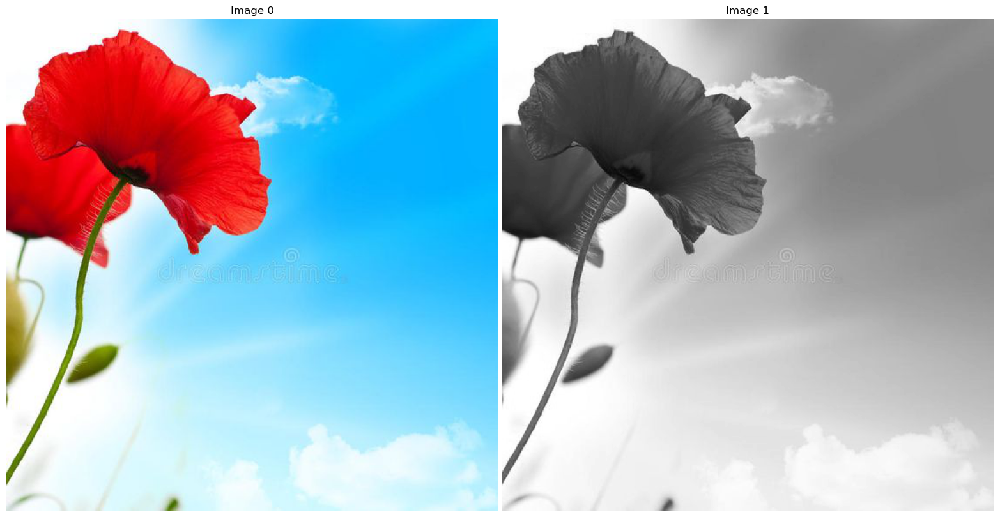

In [6]:
# Read Image
img_color = imread("C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\img_41.jpg")
# Convert Image into Gray
img_gray = cv2.cvtColor(img_color, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([img_color, img_gray], 1,2)


- Biến đổi DFT và hiển thị ảnh ở miền tần số 


In [7]:
def Image3Dto2D(image):
    if (len(image.shape) >=3 ):
        image_2D = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    else:
        image_2D = image.copy()
    return image_2D

In [8]:
# Biến đổi DFT và hiển thị ảnh ở miền tần số
def DFT_Transformation(image):
    img = Image3Dto2D(image)

    img_float32 = np.float32(img)
    dft = cv2.dft(img_float32, flags=cv2.DFT_COMPLEX_OUTPUT)
    dft_shift = np.fft.fftshift(dft)
    magnitude_spectrum = 20 * np.log(cv2.magnitude(dft_shift[:, :, 0], dft_shift[:, :, 1]))

    return magnitude_spectrum, dft_shift

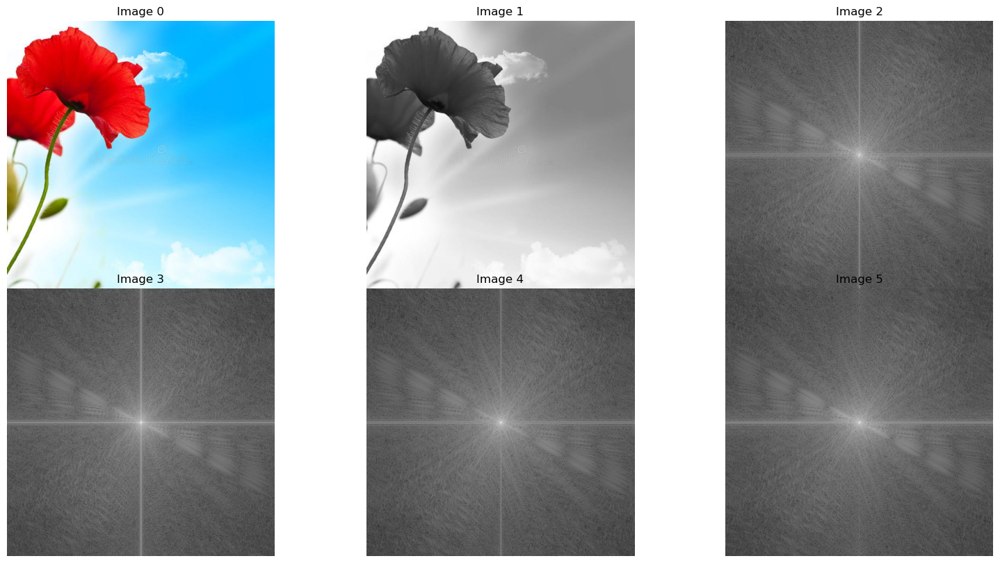

In [9]:
image_dft_frequency, dft_shift = DFT_Transformation(img_gray)
image_dft_frequency1, dft_shift1 = DFT_Transformation(img_color[:,:,0])
image_dft_frequency2, dft_shift2 = DFT_Transformation(img_color[:,:,1])
image_dft_frequency3, dft_shift3 = DFT_Transformation(img_color[:,:,2])

ShowImage([img_color, img_gray,  image_dft_frequency, image_dft_frequency1, image_dft_frequency2, image_dft_frequency3], 2, 3)


- Thực hiện tạo ảnh mask để bỏ miền tần số cao và hiển thị ảnh texture 


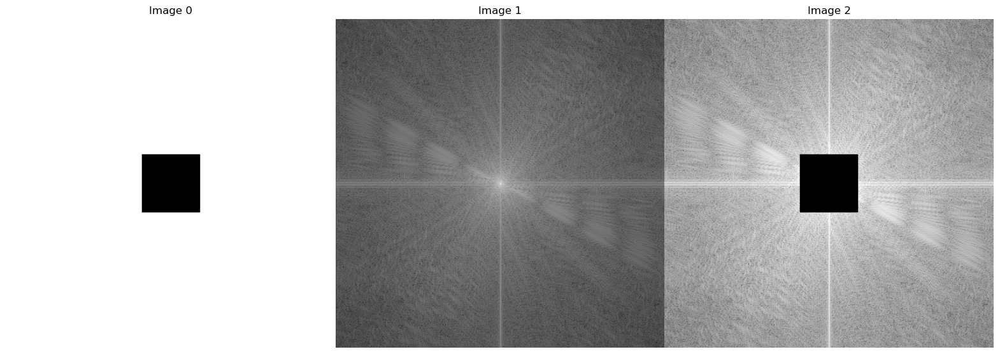

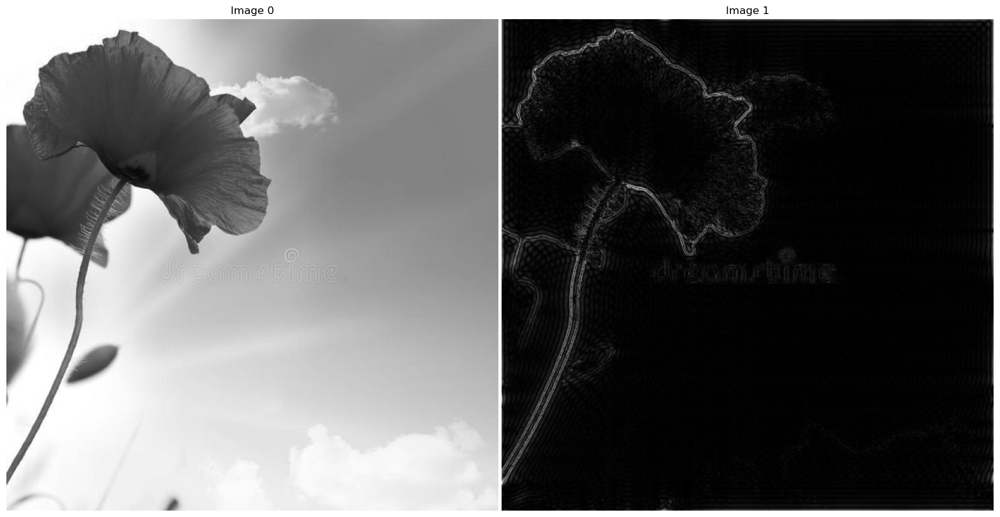

In [10]:
# Tạo ảnh mask để bỏ miền tần số cao và hiển thị ảnh texture
rows, cols = img_gray.shape
crow,ccol = (int)(rows/2) , (int)(cols/2)

# create a mask first, center square is 1, remaining all zeros
mask = np.zeros((rows, cols, 2), np.uint8)
size = 50
mask[crow-size:crow+size, ccol-size:ccol+size] = 1
mask = 1 - mask
image_dft_frequency_crop = image_dft_frequency* mask[:,:,0]

# apply mask and inverse DFT
fshift = dft_shift*mask
f_ishift = np.fft.ifftshift(fshift)
img_inverse = cv2.idft(f_ishift)
image_inverse = cv2.magnitude(img_inverse[:,:,0],img_inverse[:,:,1])

ShowImage([mask[:,:,0], image_dft_frequency, image_dft_frequency_crop], 1, 3)
ShowImage([img_gray, image_inverse], 1, 2)

- Thực hiện tạo ảnh mask để bỏ miền tần số thấp và hiển thị ảnh edge 

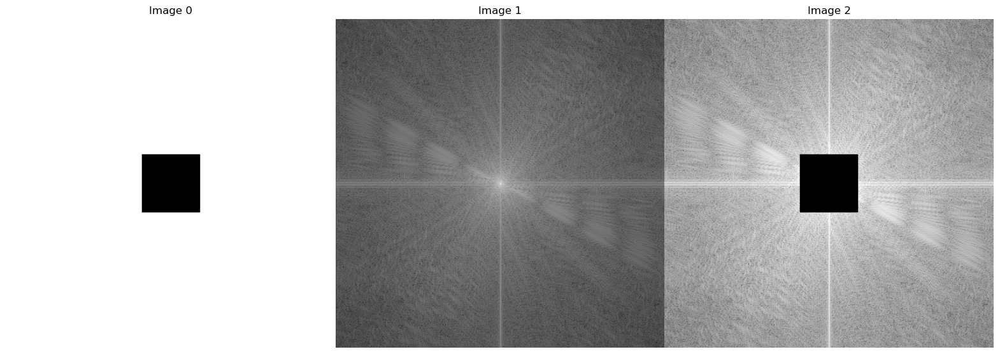

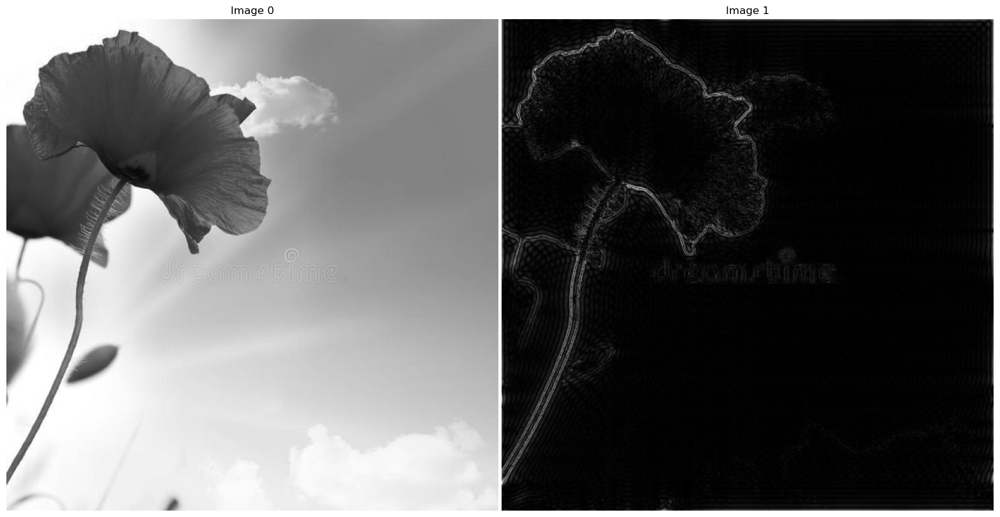

In [11]:
rows, cols = img_gray.shape
crow,ccol = (int)(rows/2) , (int)(cols/2)

# create a mask first, center square is 1, remaining all zeros
mask = np.zeros((rows, cols, 2), np.uint8)
size = 50
mask[crow-size:crow+size, ccol-size:ccol+size] = 1
mask = 1 - mask
image_dft_frequency_crop = image_dft_frequency* mask[:,:,0]

# apply mask and inverse DFT
fshift = dft_shift*mask
f_ishift = np.fft.ifftshift(fshift)
img_inverse = cv2.idft(f_ishift)
image_inverse = cv2.magnitude(img_inverse[:,:,0],img_inverse[:,:,1])

ShowImage([mask[:,:,0], image_dft_frequency, image_dft_frequency_crop], 1, 3)
ShowImage([img_gray, image_inverse], 1, 2)

- Thực hiện tạo ảnh mask như sau và thực hiện thay đổi miền tần số sau đó xuất ảnh kết quả 

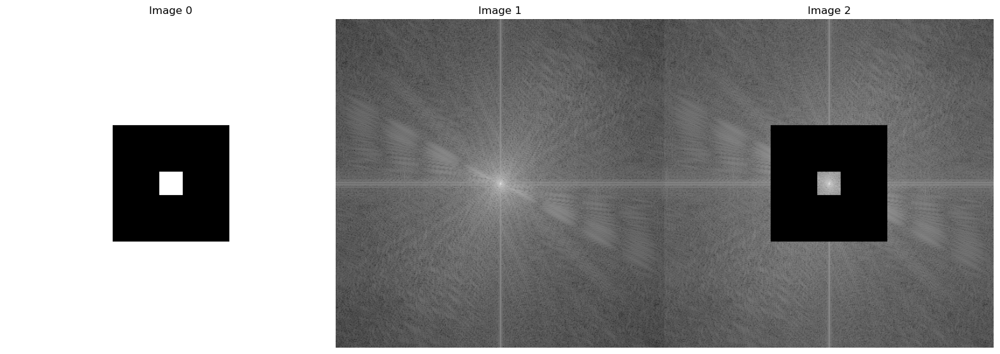

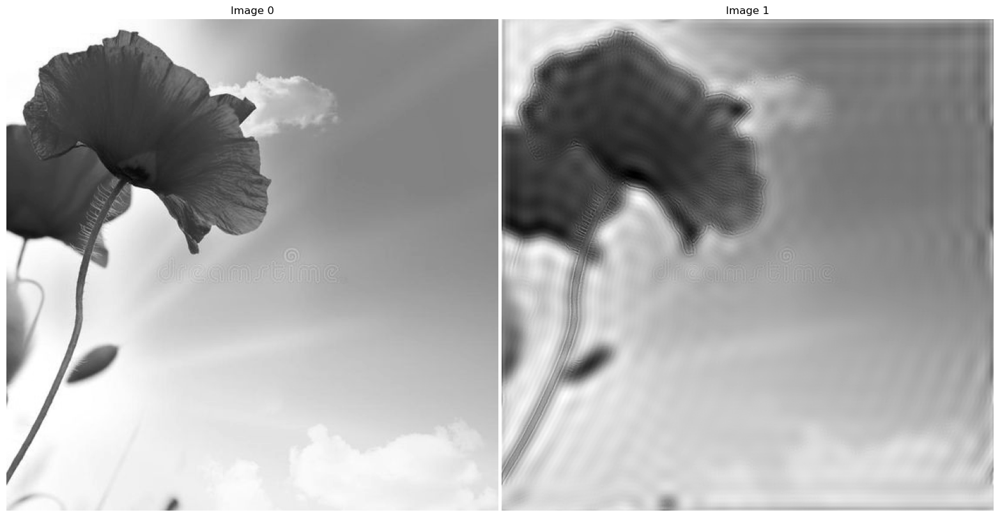

In [12]:
rows, cols = img_gray.shape
crow,ccol = (int)(rows/2) , (int)(cols/2)

# create a mask first, center square is 1, remaining all zeros
mask1 = np.zeros((rows, cols, 2), np.uint8)
mask2 = np.zeros((rows, cols, 2), np.uint8)

size = 20
mask1[crow-size:crow+size, ccol-size:ccol+size] = 1

size = 100
mask2[crow-size:crow+size, ccol-size:ccol+size] = 1


mask = np.zeros((rows, cols, 2), np.uint8)
mask[(mask1 == 1) | (mask2 == 0)] = 1

image_dft_frequency_crop = image_dft_frequency* mask[:,:,0]

# apply mask and inverse DFT
fshift = dft_shift*mask
f_ishift = np.fft.ifftshift(fshift)
img_inverse = cv2.idft(f_ishift)
image_inverse = cv2.magnitude(img_inverse[:,:,0],img_inverse[:,:,1])

ShowImage([mask[:,:,0], image_dft_frequency, image_dft_frequency_crop], 1, 3)
ShowImage([img_gray, image_inverse], 1, 2)

2. Kiếm một ảnh trên internet và thực hiện các bước sau: 
- Chuyển đổi thành ảnh xám
- Biến đổi DCT và hiển thị ảnh DCT 
- Đặt ngưỡng giữ lại khoảng 5% hệ số DCT và hiển thị ảnh nén kết quả 


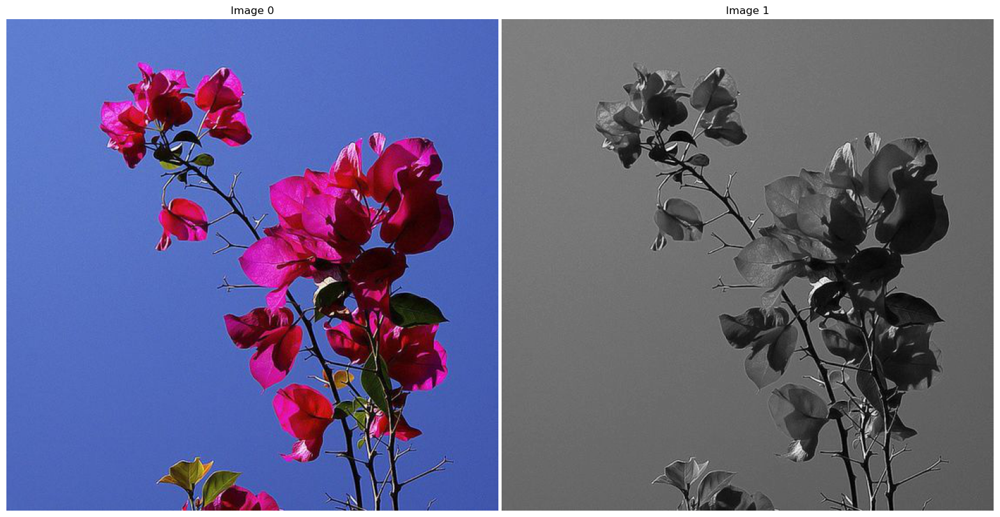

In [13]:
# Read Image 
image_color = imread("C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\img_42.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_color, image_gray], 1, 2)

- Biến đổi DCT và hiển thị ảnh DCT 


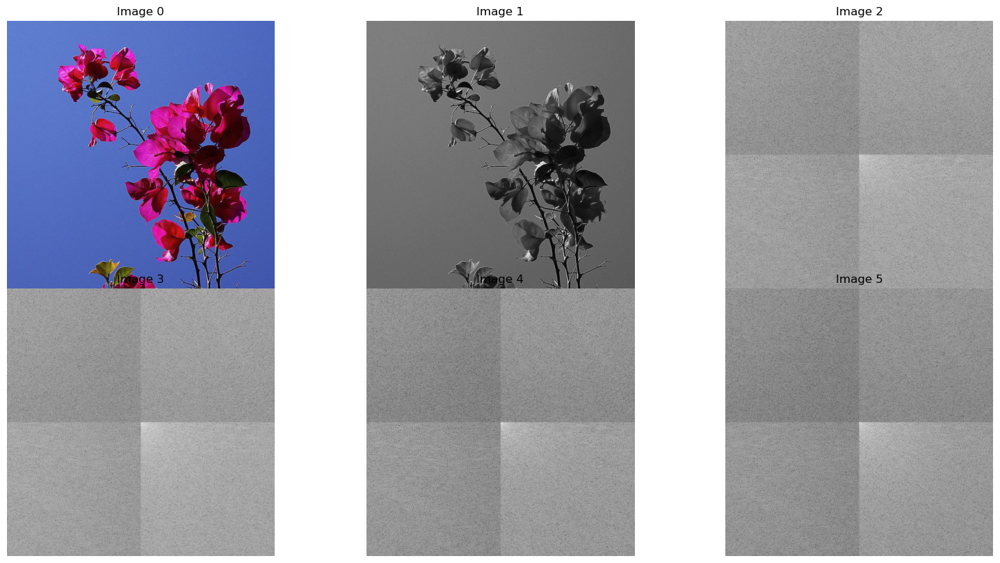

In [14]:
def Image3Dto2D(image):
    if len(image.shape) >= 3:
        image_2D = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    else:
        image_2D = image.copy()
    return image_2D

def DCT_Transformation(image):
    img = Image3Dto2D(image)

    # Thực hiện biến đổi DCT
    dct = cv2.dct(np.float32(img))
    dct_shift = np.fft.fftshift(dct)
    magnitude_spectrum_dct = 20 * np.log(cv2.magnitude(dct_shift, np.zeros_like(dct_shift)))

    return magnitude_spectrum_dct, dct_shift

# Thực hiện biến đổi DCT và hiển thị ảnh DCT
image_dct_frequency, dct_shift = DCT_Transformation(image_gray)
image_dct_frequency1, dct_shift1 = DCT_Transformation(image_color[:, :, 0])
image_dct_frequency2, dct_shift2 = DCT_Transformation(image_color[:, :, 1])
image_dct_frequency3, dct_shift3 = DCT_Transformation(image_color[:, :, 2])

ShowImage([image_color, image_gray, image_dct_frequency, image_dct_frequency1, image_dct_frequency2, image_dct_frequency3], 2, 3)


- Đặt ngưỡng giữ lại khoảng 5% hệ số DCT và hiển thị ảnh nén kết quả 


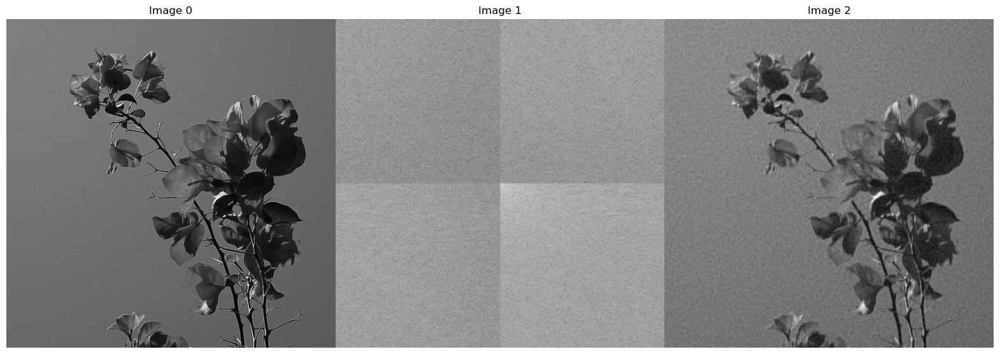

In [15]:
def compress_dct(image, percent_retain=5):
    img_float32 = np.float32(image)
    dct = cv2.dct(img_float32)
    dct_shift = np.fft.fftshift(dct)

    # Tính toán ngưỡng dựa trên phần trăm được giữ lại
    rows, cols = img_float32.shape
    total_coefficients = rows * cols
    retain_coefficients = int((percent_retain / 100.0) * total_coefficients)

    # Sắp xếp các hệ số DCT theo độ lớn giảm dần và giữ lại chỉ số cần thiết
    sorted_indices = np.argsort(np.abs(dct_shift), axis=None)[::-1]
    compressed_indices = np.unravel_index(sorted_indices[:retain_coefficients], (rows, cols))

    # Tạo mask để giữ lại chỉ số cần thiết
    mask = np.zeros_like(dct_shift)
    mask[compressed_indices] = 1

    # Áp dụng mask lên DCT shift
    dct_shift_compressed = dct_shift * mask

    # Thực hiện biến đổi ngược DCT để lấy ảnh nén
    img_compressed = cv2.idct(np.fft.ifftshift(dct_shift_compressed))

    return img_compressed


# Thực hiện biến đổi DCT và hiển thị ảnh DCT
image_dct_frequency, dct_shift = DCT_Transformation(image_gray)

# Đặt ngưỡng giữ lại khoảng 5% hệ số DCT và hiển thị ảnh nén kết quả
compressed_image = compress_dct(image_gray, percent_retain=5)

ShowImage([image_gray, image_dct_frequency, compressed_image], 1,3)


3. Kiếm một ảnh màu trên internet và thực hiện nén các ảnh này dùng DFT và DCT bằng cách giữ lại 5% hệ số. Sau đó khôi phục lại ảnh màu và lưu xuống thư mục cũng như xuất dung lượng ảnh xem giảm được bao nhiêu dung lượng (Gợi ý dùng không gian HSV nén V nhưng vẫn giữ được màu, thử nén H và S)

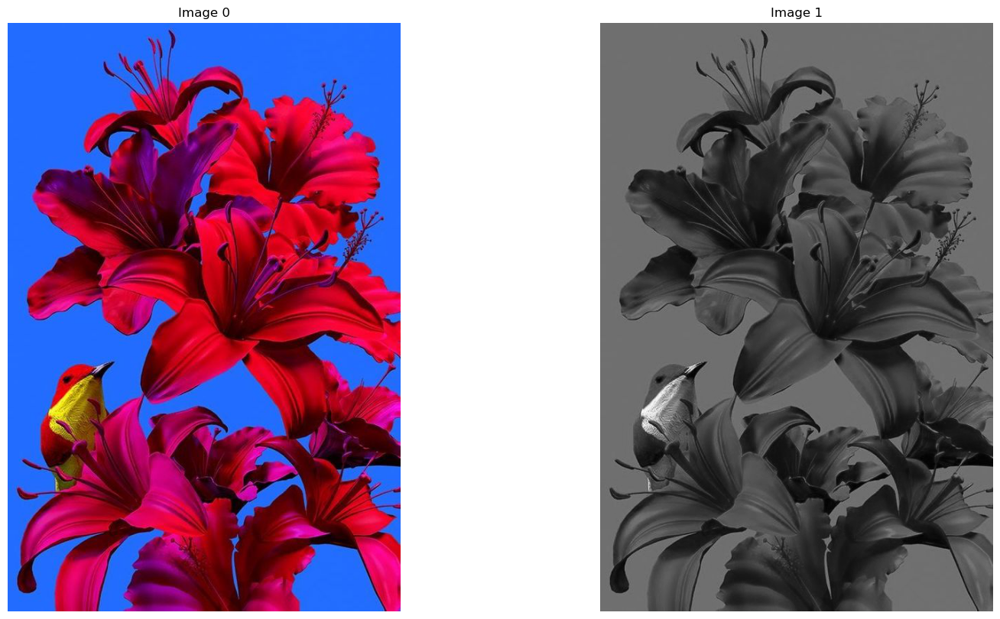

In [16]:
# Read Image 
image_color = imread("C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\img_43.jpg")
# Convert Image into Gray
image_gray = cv2.cvtColor(image_color, cv2.COLOR_RGB2GRAY)

# Display Image
ShowImage([image_color, image_gray], 1, 2)

In [17]:
def dct2(a):
    import scipy
    return scipy.fftpack.dct( scipy.fftpack.dct( a, axis=0, norm='ortho' ), axis=1, norm='ortho' )

def idct2(a):
    import scipy
    return scipy.fftpack.idct( scipy.fftpack.idct( a, axis=0 , norm='ortho'), axis=1 , norm='ortho')

In [18]:
im = image_gray
imsize = im.shape
dct = np.zeros(imsize)

# Do 8x8 DCT on image (in-place)
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dct[i:(i+8),j:(j+8)] = dct2( im[i:(i+8),j:(j+8)] )

Text(0.5, 1.0, 'An 8x8 DCT block')

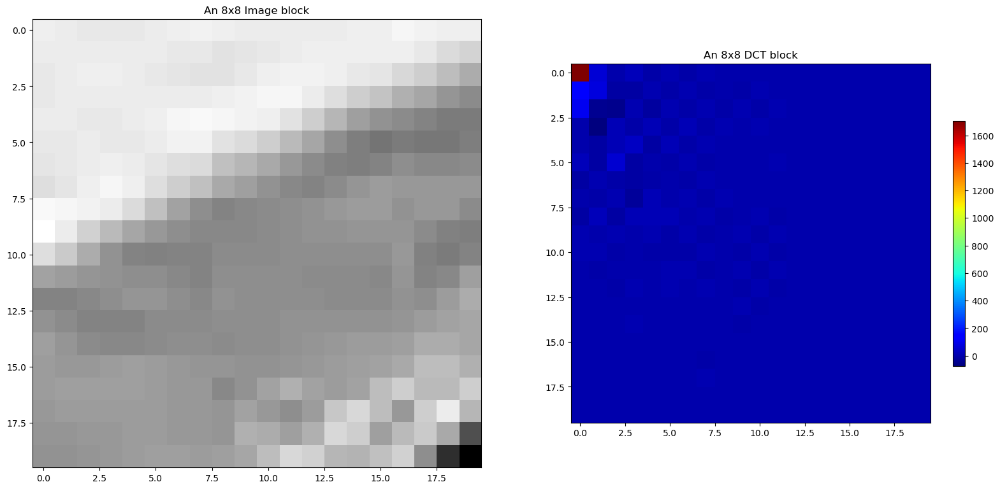

In [19]:
pos = 128
SampleBlock = im[pos:pos+20,pos:pos+20]
SampleDCT = dct2(SampleBlock)

plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.imshow(SampleBlock,cmap='gray')
plt.title( "An 8x8 Image block")

# Display the dct of that block
plt.subplot(1,2,2)
plt.imshow(SampleDCT,cmap=cm.jet,interpolation='nearest')
plt.colorbar(shrink=0.5)
plt.title( "An 8x8 DCT block")

Text(0.5, 1.0, '8x8 DCTs of the image')

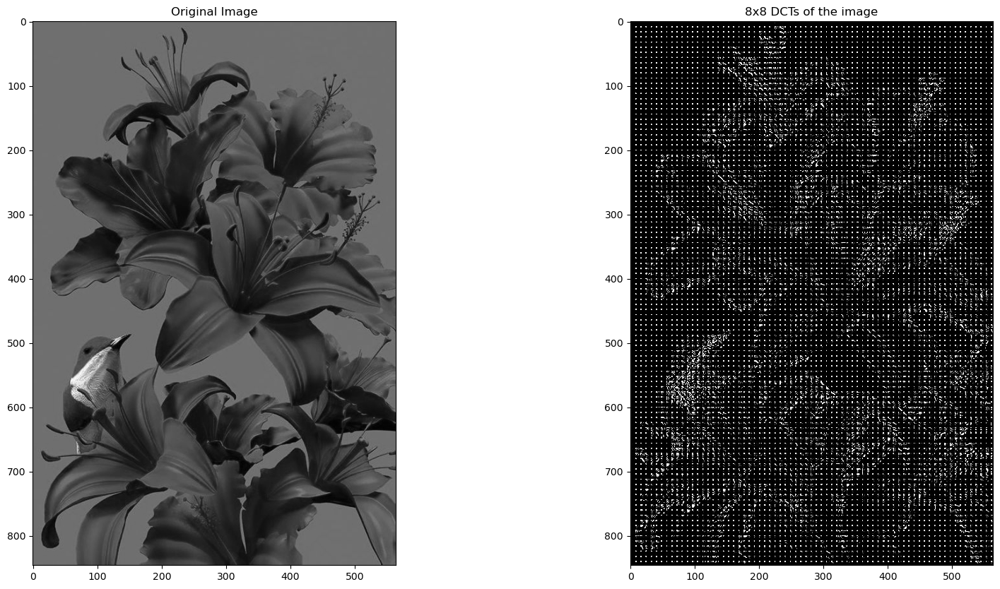

In [20]:
# Display entire DCT
plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.imshow(image_gray, cmap = 'gray')
plt.title( "Original Image")
plt.subplot(1,2,2)
plt.imshow(dct,cmap='gray',vmax = np.max(dct)*0.01,vmin = 0)
plt.title( "8x8 DCTs of the image")


Keeping only 1.910325% of the DCT coefficients
Comparison between original and DCT compressed images


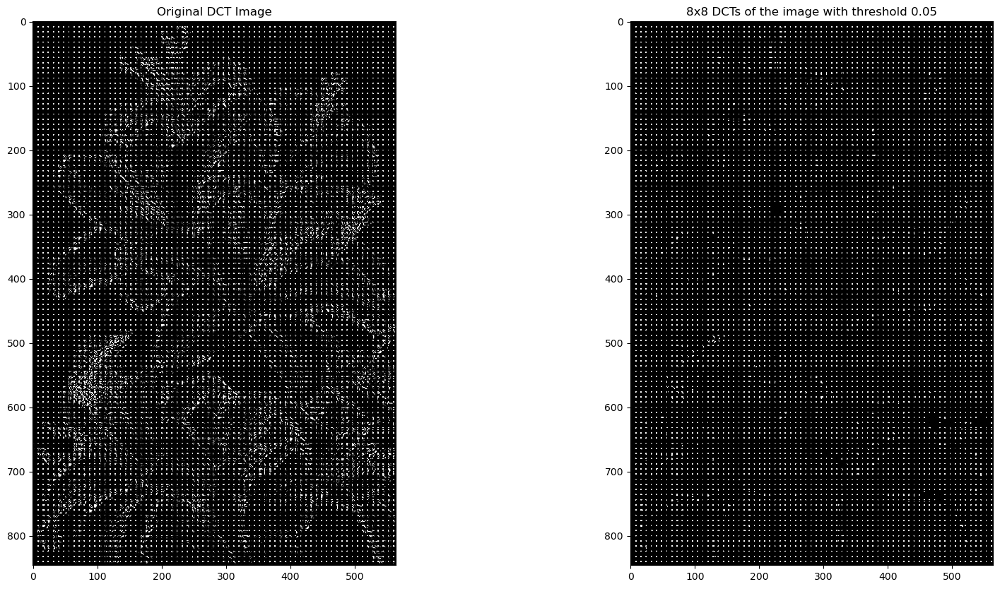

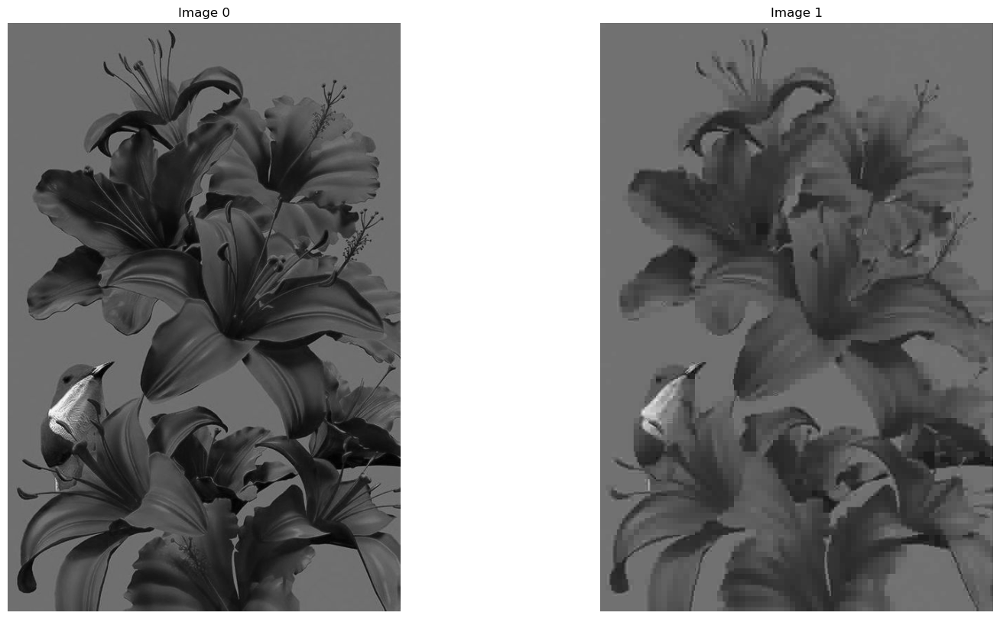

In [21]:
# Threshold
thresh = 0.05
dct_thresh = dct * (abs(dct) > (thresh*np.max(dct)))

plt.figure(figsize=(20,10))
plt.subplot(1,2,1)
plt.imshow(dct,cmap='gray',vmax = np.max(dct)*0.01,vmin = 0)
plt.title( "Original DCT Image")
plt.subplot(1,2,2)
plt.imshow(dct_thresh,cmap='gray',vmax = np.max(dct)*0.01,vmin = 0)
plt.title( "8x8 DCTs of the image with threshold " + str(thresh))


percent_nonzeros = np.sum( dct_thresh != 0.0 ) / (imsize[0]*imsize[1]*1.0)
print("Keeping only %f%% of the DCT coefficients" % (percent_nonzeros*100.0))

im_dct = np.zeros(imsize)
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        im_dct[i:(i+8),j:(j+8)] = idct2( dct_thresh[i:(i+8),j:(j+8)] )
        
print("Comparison between original and DCT compressed images" )
ShowImage([im, im_dct])

Keeping only 1.910325% of the DCT coefficients
Keeping only 5.976183% of the DFT coefficients
Comparison between original, DCT compressed and DFT compressed images


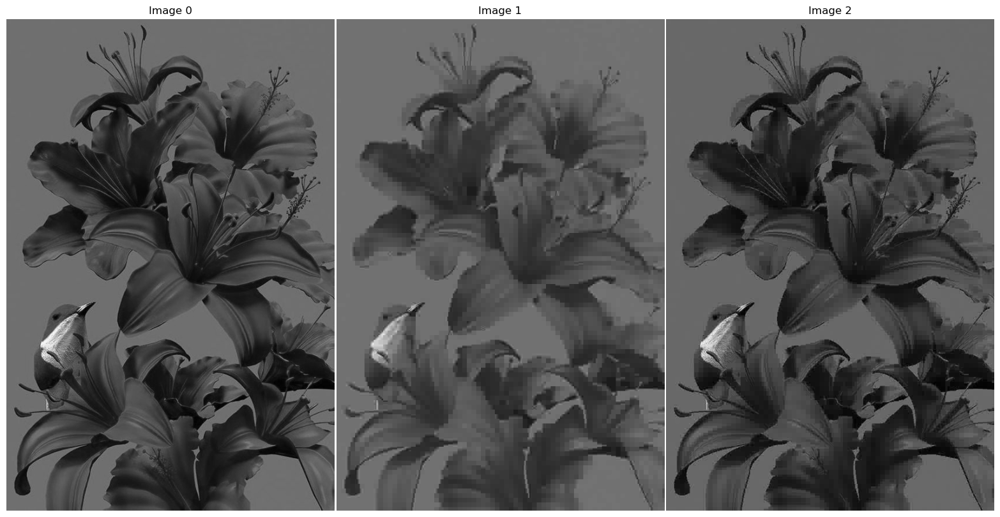

In [22]:
dft = np.zeros(imsize,dtype='complex');
im_dft = np.zeros(imsize,dtype='complex');

# 8x8 DFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        dft[i:(i+8),j:(j+8)] = np.fft.fft2( im[i:(i+8),j:(j+8)] )

# Thresh
thresh = 0.013
dft_thresh = dft * (abs(dft) > (thresh*np.max(abs(dft))))


percent_nonzeros_dft = np.sum( dft_thresh != 0.0 ) / (imsize[0]*imsize[1]*1.0)
print("Keeping only %f%% of the DCT coefficients" % (percent_nonzeros*100.0))
print("Keeping only %f%% of the DFT coefficients" % (percent_nonzeros_dft*100.0))

# 8x8 iDFT
for i in np.r_[:imsize[0]:8]:
    for j in np.r_[:imsize[1]:8]:
        im_dft[i:(i+8),j:(j+8)] = np.fft.ifft2( dft_thresh[i:(i+8),j:(j+8)] )
        
print("Comparison between original, DCT compressed and DFT compressed images")
ShowImage([im, im_dct, abs(im_dft)], 1, 3)

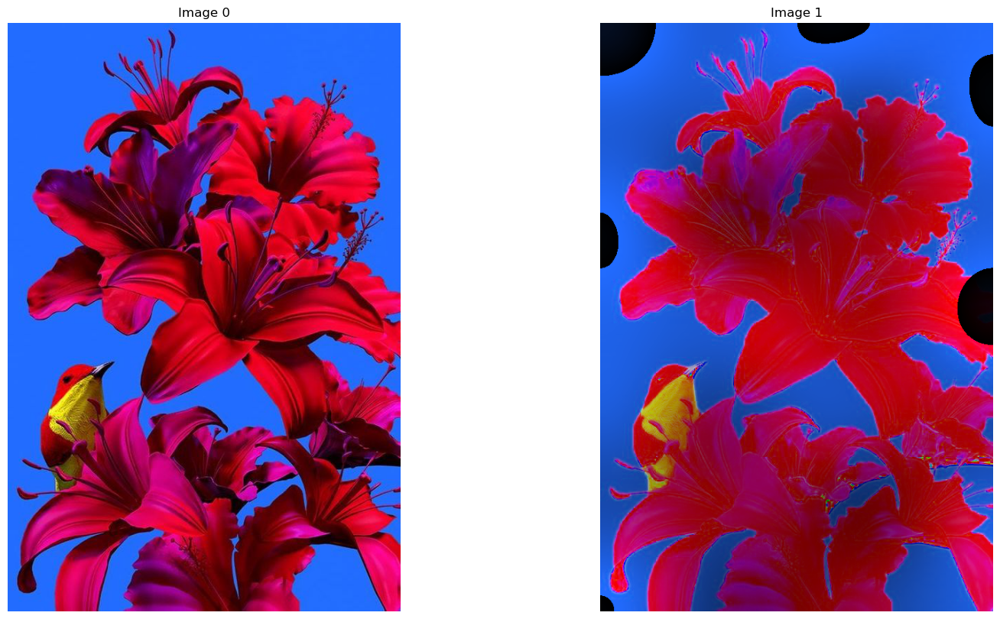

Original Size: 1.37 MB
Compressed Size: 1.37 MB
Compression Ratio: 1.00


In [23]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Đọc ảnh màu
image_color = cv2.imread("C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\img_43.jpg")
image_rgb = cv2.cvtColor(image_color, cv2.COLOR_BGR2RGB)

# Chuyển đổi sang không gian màu HSV
image_hsv = cv2.cvtColor(image_rgb, cv2.COLOR_RGB2HSV)

# Lấy kênh V (Value)
v_channel = image_hsv[:, :, 2]

# Thực hiện DCT trên kênh V
dct_v = cv2.dct(np.float32(v_channel))

# Giữ lại 5% hệ số
thresh = 0.05
dct_v_thresh = dct_v * (np.abs(dct_v) > (thresh * np.max(np.abs(dct_v))))

# Thực hiện iDCT để khôi phục kênh V
v_channel_restored = cv2.idct(dct_v_thresh)

# Gán kênh V đã nén vào không gian màu HSV
image_hsv[:, :, 2] = np.uint8(v_channel_restored)

# Chuyển đổi lại thành không gian màu RGB
compressed_image_rgb = cv2.cvtColor(image_hsv, cv2.COLOR_HSV2RGB)

# Hiển thị ảnh gốc và ảnh đã nén
ShowImage([image_rgb, compressed_image_rgb], 1,2)

# Lưu ảnh đã nén xuống thư mục
cv2.imwrite("path/to/your/output/folder/compressed_image.jpg", cv2.cvtColor(compressed_image_rgb, cv2.COLOR_RGB2BGR))

# Xuất dung lượng giảm được
original_size = image_rgb.nbytes / (1024 * 1024)  # in MB
compressed_size = compressed_image_rgb.nbytes / (1024 * 1024)  # in MB
compression_ratio = original_size / compressed_size

print(f"Original Size: {original_size:.2f} MB")
print(f"Compressed Size: {compressed_size:.2f} MB")
print(f"Compression Ratio: {compression_ratio:.2f}")


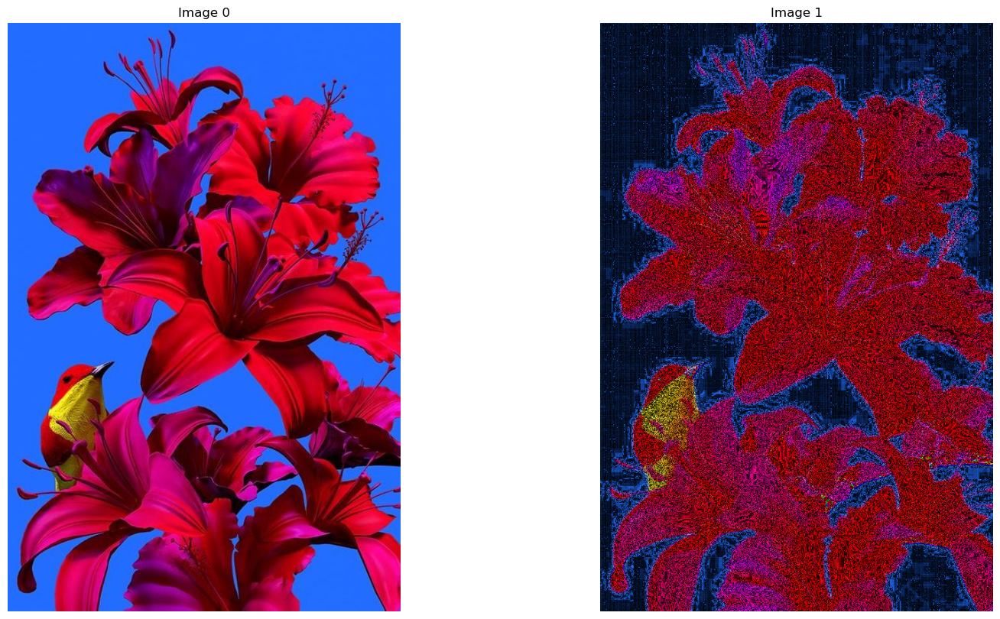

In [24]:
import cv2
import numpy as np

# Đọc ảnh màu từ đường dẫn
image_path = "C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\img_43.jpg"
original_image = cv2.imread(image_path)

# Chuyển đổi không gian màu từ BGR sang HSV
hsv_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2HSV)

# Áp dụng DFT cho kênh V của không gian màu HSV
v_channel = hsv_image[:, :, 2]
dft_v = cv2.dft(np.float32(v_channel), flags=cv2.DFT_COMPLEX_OUTPUT)
magnitude_spectrum_v = np.log(cv2.magnitude(dft_v[:, :, 0], dft_v[:, :, 1]) + 1)

# Giữ lại 5% hệ số
rows, cols = v_channel.shape
crow, ccol = rows // 2, cols // 2
magnitude_spectrum_v[int(crow - 0.05 * crow):int(crow + 0.05 * crow), int(ccol - 0.05 * ccol):int(ccol + 0.05 * ccol)] = 0

# Áp dụng IDFT để khôi phục kênh V
idft_v = cv2.idft(dft_v)
restored_v_channel = cv2.magnitude(idft_v[:, :, 0], idft_v[:, :, 1])

# Gán lại kênh V đã nén vào không gian màu HSV
hsv_image[:, :, 2] = np.uint8(restored_v_channel)

# Chuyển đổi lại thành không gian màu BGR
compressed_image = cv2.cvtColor(hsv_image, cv2.COLOR_HSV2BGR)

# Lưu ảnh xuống thư mục mới
output_path = 'path/to/your/output/folder/compressed_image.jpg'
cv2.imwrite(output_path, compressed_image)

# Xuất dung lượng giảm được
original_size = original_image.nbytes / (1024 * 1024)  # in MB
compressed_size = compressed_image.nbytes / (1024 * 1024)  # in MB
compression_ratio = original_size / compressed_size


# Chuyển đổi không gian màu từ BGR sang RGB để hiển thị bằng matplotlib
original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)

# Ảnh đã nén
compressed_image_rgb = cv2.cvtColor(compressed_image, cv2.COLOR_BGR2RGB)

ShowImage([original_image_rgb, compressed_image_rgb], 1,2)

# Làm thêm

- Chuyển đổi ảnh thành tranh vẽ
    - Ảnh được chuyển đổi sang ảnh xám và sau đó làm mờ để loại bỏ chi tiết không mong muốn.
    - Sử dụng phương pháp Canny để phát hiện các cạnh trong ảnh.
    - Kết hợp ảnh gốc với đường viền để tạo ra ảnh tranh vẽ.

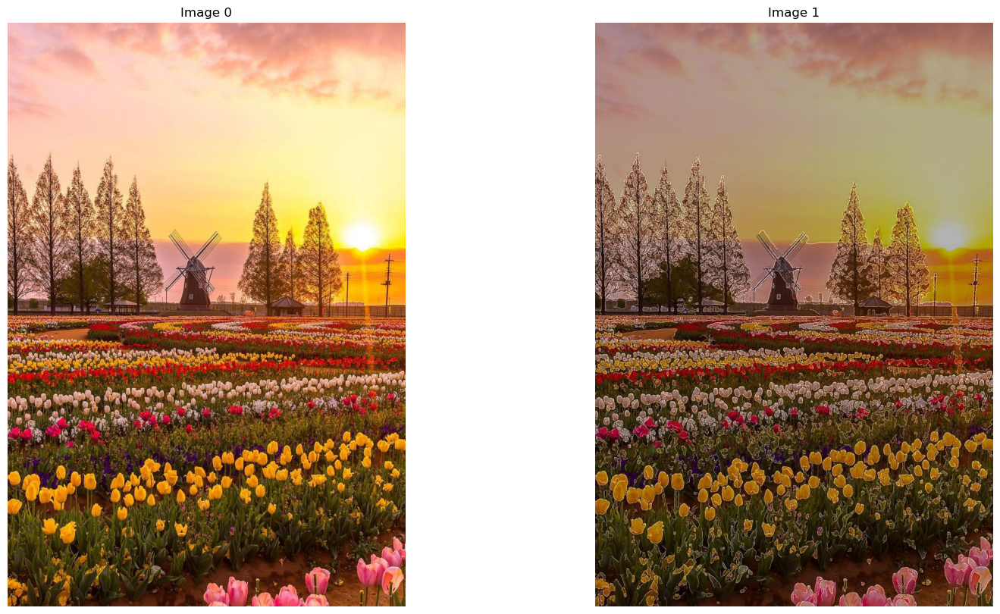

In [25]:
# Đọc ảnh
image_path = "C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\lamthem.jpg"
image = cv2.imread(image_path)
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Chuyển đổi sang ảnh xám
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Làm mờ ảnh để loại bỏ chi tiết
blurred_image = cv2.medianBlur(gray_image, 5)

# Phát hiện các cạnh bằng phương pháp Canny
edges = cv2.Canny(blurred_image, 50, 150)

# Chuyển đổi ảnh xám sang ảnh màu để có thể vẽ các đường viền màu trên ảnh gốc
edges_colored = cv2.cvtColor(edges, cv2.COLOR_GRAY2RGB)

# Kết hợp ảnh gốc với các đường viền
cartoon_image = cv2.addWeighted(image_rgb, 0.7, edges_colored, 0.3, 0)

# Hiển thị ảnh gốc và ảnh đã chuyển đổi
ShowImage([image_rgb, cartoon_image], 1,2)


- Phân tích cảm xúc trong khuôn mặt, sử dụng các mô hình học máy đã được đào tạo để nhận diện cảm xúc từ hình ảnh khuôn mặt. 
- Sử dụng mô hình "Facial Expression Recognition" (FER).

1/1 [==============================] - 0s 22ms/step


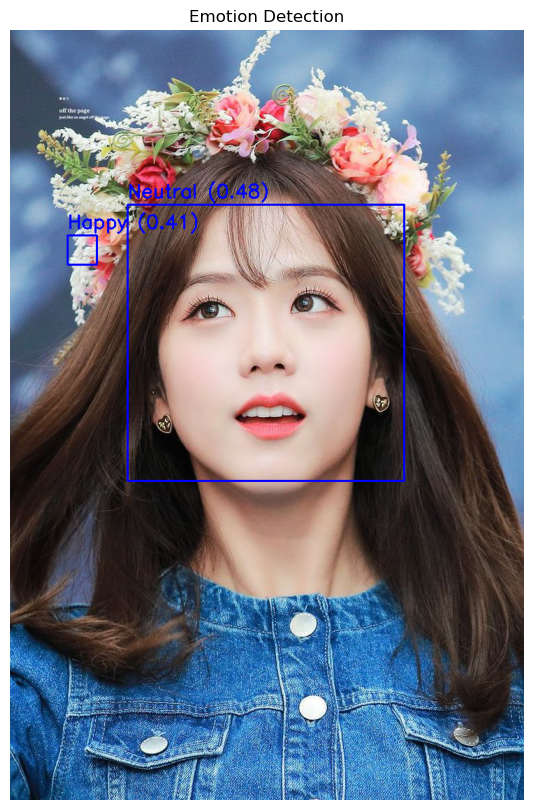

In [31]:
import cv2
import numpy as np
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

# Đường dẫn đến pre-trained model
model_path = "C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\model_v6_23.hdf5"
emotion_labels = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']

# Load pre-trained model
emotion_model = load_model(model_path)

# Hàm nhận diện cảm xúc từ khuôn mặt
def detect_emotion(face_roi):
    face_roi = cv2.resize(face_roi, (48, 48))
    face_roi = np.expand_dims(face_roi, axis=0)
    face_roi = face_roi / 255.0  # Chuẩn hóa giá trị pixel về khoảng 0-1

    emotion_pred = emotion_model.predict(face_roi)
    emotion_label = emotion_labels[np.argmax(emotion_pred)]
    emotion_confidence = np.max(emotion_pred)

    return emotion_label, emotion_confidence

# Hàm nhận diện khuôn mặt và cảm xúc từ ảnh
def detect_faces_and_emotions(image_path):
    # Đọc ảnh
    image = cv2.imread(image_path)
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Full path to the Haar cascade file
    haarcascade_path = "D:\\Acea Smart Water Analytics\\haarcascade_frontalface_default.xml"
    
    # Load pre-trained face detection model
    face_cascade = cv2.CascadeClassifier(haarcascade_path)

    # Detect faces
    faces = face_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=5, minSize=(30, 30))

    # Với mỗi khuôn mặt, nhận diện cảm xúc và vẽ hình chữ nhật
    for (x, y, w, h) in faces:
        face_roi = gray[y:y + h, x:x + w]
        emotion_label, emotion_confidence = detect_emotion(face_roi)

        # Vẽ hình chữ nhật quanh khuôn mặt và hiển thị cảm xúc
        cv2.rectangle(image, (x, y), (x + w, y + h), (255, 0, 0), 2)
        cv2.putText(image, f"{emotion_label} ({emotion_confidence:.2f})", (x, y - 10),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 0, 0), 2)

    return image

# Gọi hàm để nhận diện cảm xúc từ ảnh
annotated_image = detect_faces_and_emotions("C:\\Users\\Quynh Nhu\\Downloads\\.ipynb_checkpoints\\jisoo.jpg")

# Hiển thị ảnh đã chú thích
plt.figure(figsize=(16,10))
plt.imshow(cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB))
plt.title("Emotion Detection")
plt.axis("off")
plt.show()
